In [1]:
from scanpy_recipes import sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

Running Scanpy 1.3.7 on 2020-08-05 09:25.


# *Aggr : 
## RV18001 - RV18002 - RV18003 
## RV19001 - RV19002 - RV19004 - RV19005 - RV19006 - RV19007 - RV19008 - RV19009

## Loading data

In [3]:
ac = sc.AnalysisConfig()

In [4]:
#ac.print_template()

In [5]:
config_string = """
[names]
pi_name = Roel Verhaak
customer_name = Kevin Johnson
analyst_name = Martine Seignon
analysis_name = Glioma aggregation preliminary analysis

[sample_names]
RV18001 = astrocytoma
RV18002 = glioma
RV18003 = glioma
RV19001 = glioma
RV19002 = glioma
RV19004 = glioma 
RV19005 = glioma
RV19006 = glioblastoma
RV19007 = glioblastoma
RV19008 = glioblastoma
RV19009 = glioblastoma

[genomes]
RV18001 = hg19
RV18002 = hg19 
RV18003 = hg19
RV19001 = hg19
RV19002 = hg19
RV19004 = hg19
RV19005 = hg19
RV19006 = hg19
RV19007 = hg19
RV19008 = hg19
RV19009 = hg19

[species]
hg19 = hsapiens
GRCh38 = hsapiens
mm10 = mmusculus

[input_dirs]
RV18001 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV18001/cellranger/
RV18002 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV18002-hg19/
RV18003 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV18003/
RV19001 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19001/
RV19002 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19002/
RV19004 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19004-resequence/cellranger/
RV19005 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19005/cellranger/
RV19006 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19006/cellranger/
RV19007 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19007/cellranger/
RV19008 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19008/cellranger/
RV19009 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19009/cellranger/


[output_dirs]
RV18001 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9
RV18002 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9
RV18003 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9
RV19001 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9
RV19002 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9
RV19004 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9
RV19005 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9
RV19006 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9
RV19007 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9
RV19008 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9
RV19009 = /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9

[target_cells]
RV18001 = 6000
RV18002 = 6000
RV18003 = 6000
RV19001 = 6000
RV19002 = 6000
RV19004 = 6000
RV19005 = 6000
RV19006 = 6000
RV19007 = 6000
RV19008 = 6000
RV19009 = 6000

[10x_chemistry]
RV18001 = v2
RV18002 = v2
RV18003 = v2
RV19001 = v3
RV19002 = v3
RV19004 = v3
RV19005 = v3
RV19006 = v3
RV19007 = v3
RV19008 = v3
RV19009 = v3

[cellranger_version]
RV18001 = 3.0.2
RV18002 = 3.0.2
RV18003 = 3.0.2
RV19001 = 3.0.2
RV19002 = 3.0.2
RV19004 = 3.0.2
RV19005 = 3.0.2
RV19006 = 3.0.2
RV19007 = 3.0.2
RV19008 = 3.0.2
RV19009 = 3.0.2       

[reference_version]
RV18001 = 1.2.0
RV18002 = 1.2.0
RV18003 = 1.2.0
RV19001 = 1.2.0
RV19002 = 1.2.0
RV19004 = 1.2.0
RV19005 = 1.2.0
RV19006 = 1.2.0
RV19007 = 1.2.0
RV19008 = 1.2.0
RV19009 = 1.2.0

"""
config = ac.read(config_string)

In [6]:
combined_sampleid = "RV18001-2-3-RV19001-2-4-5-6-7-8-9"
combined_sample_name = "Glioma"
combined_output_dir = "/home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9"

In [7]:
sampleids = config["sample_names"]

In [8]:
adata_raws = dict((sampleid, sc.load_10x_data(sampleid, config)) for sampleid in sampleids)

reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV18001/cellranger/filtered_gene_bc_matrices_h5.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:00.56)
Ran `.var_names_make_unique()` for you.
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV18002-hg19/filtered_gene_bc_matrices_h5.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:01.47)
Ran `.var_names_make_unique()` for you.
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV18003/filtered_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:02.51)
Ran `.var_names_make_unique()` for you.
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19001/filtered_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:02.69)
Ran `.var_names_make_unique()` for you.
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19002/filtered_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:03.60)
Ran `.var_names_make_unique()` for you.
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19004-resequence/cellranger/filtered_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:02.21)
Ran `.var_names_make_unique()` for you.
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19005/cellranger/filtered_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:01.14)
Ran `.var_names_make_unique()` for you.
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19006/cellranger/filtered_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:02.60)
Ran `.var_names_make_unique()` for you.
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19007/cellranger/filtered_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:01.65)
Ran `.var_names_make_unique()` for you.
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19008/cellranger/filtered_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:02.92)
Ran `.var_names_make_unique()` for you.
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19009/cellranger/filtered_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:01.50)
Ran `.var_names_make_unique()` for you.


## Quality control and filtering

Analysis first starts by generating **per-cell** and **per-gene** metrics, that we can then use to filter the data.  We compute these before we do any aggregation

In [9]:
for adata_raw in adata_raws.values():
    sc.qc.gen_qc(adata_raw)

... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


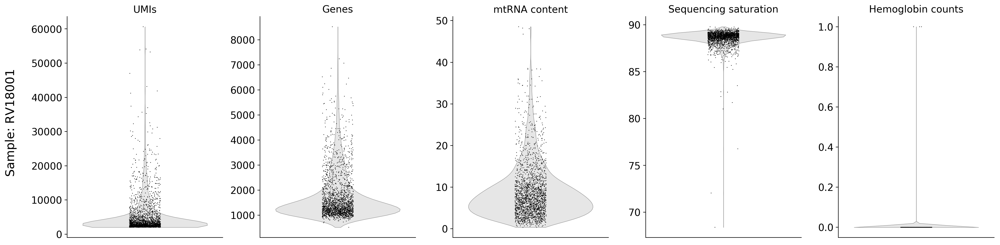

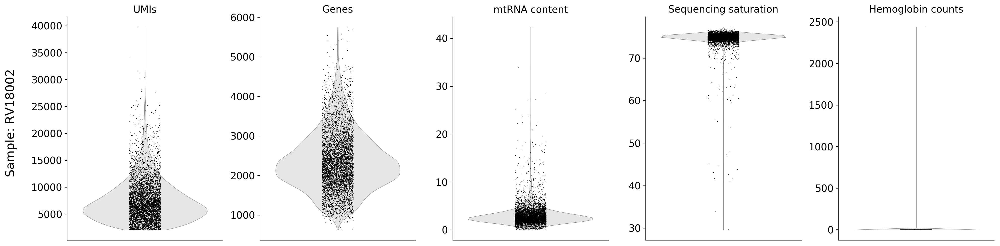

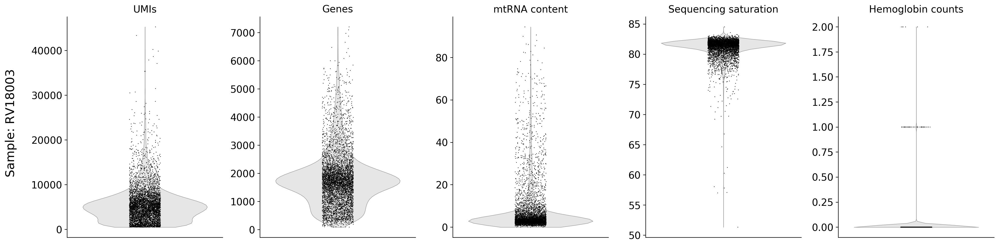

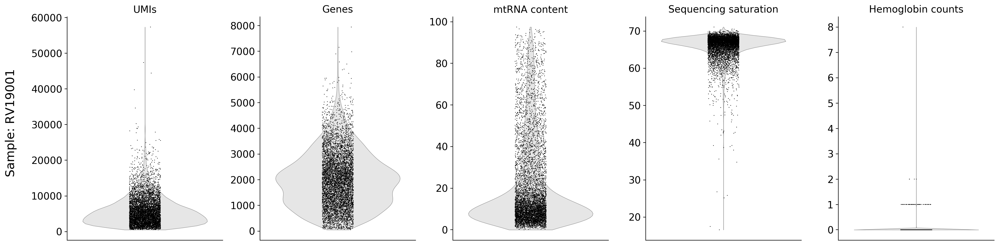

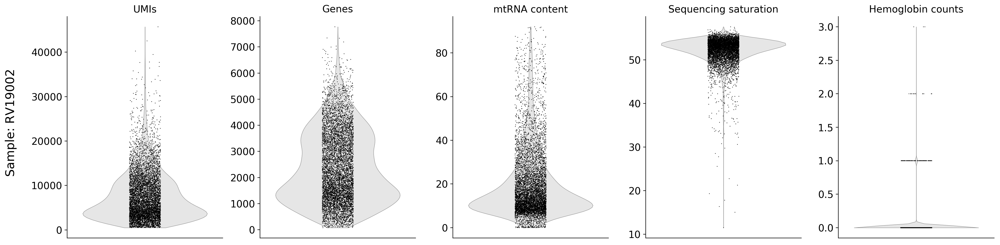

...

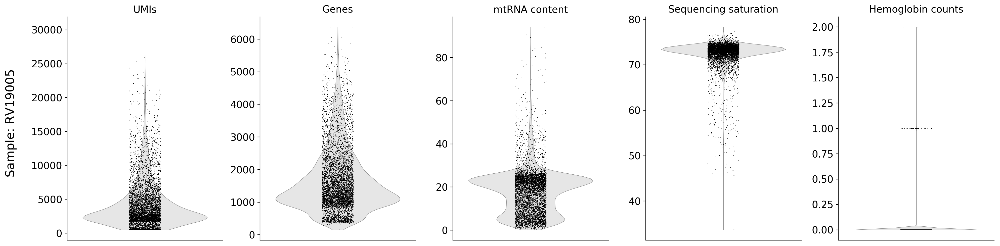

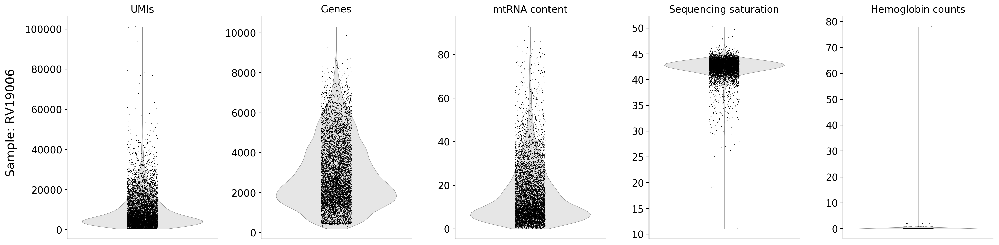

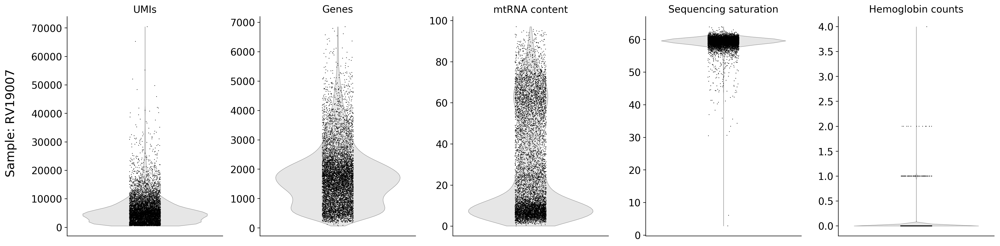

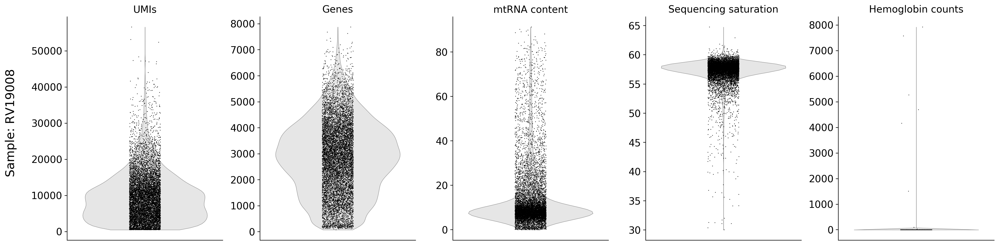

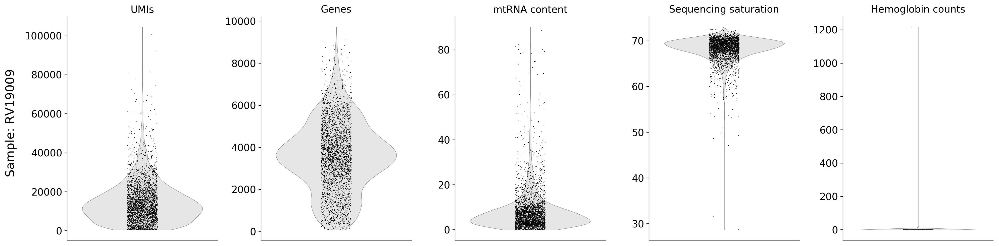

In [10]:
for adata_raw in adata_raws.values():
    sc.pl.qc_violins(adata_raw)

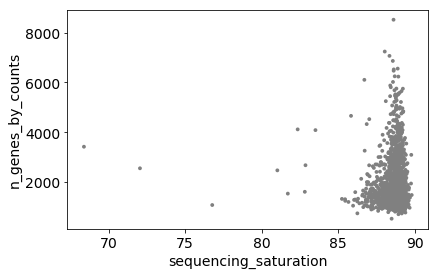

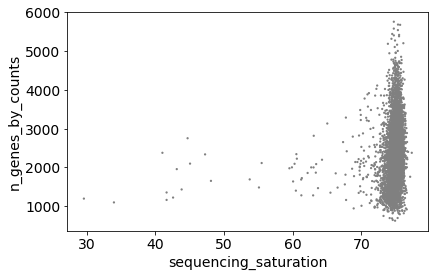

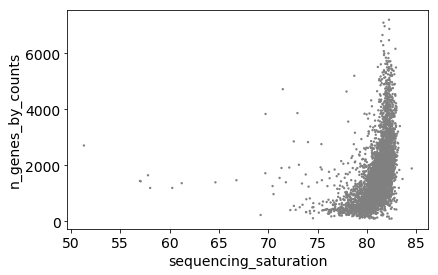

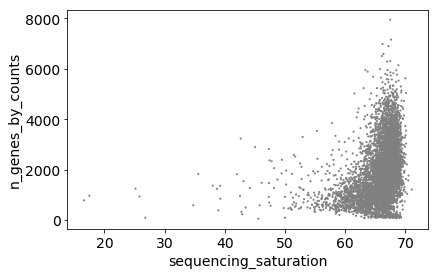

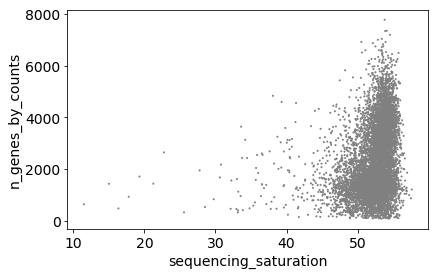

...

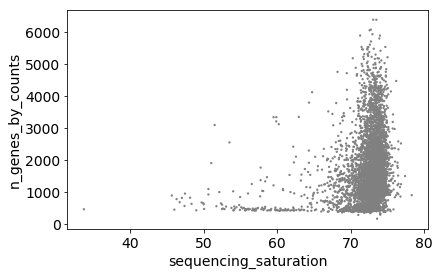

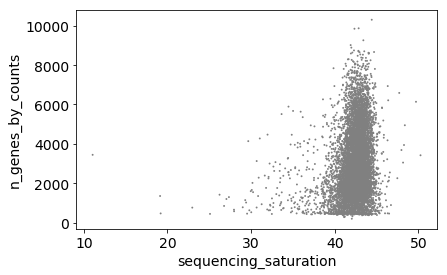

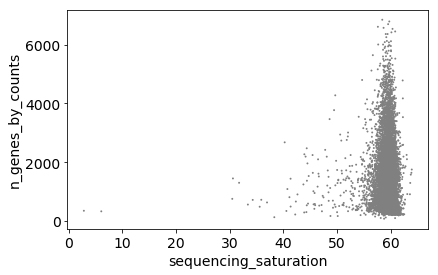

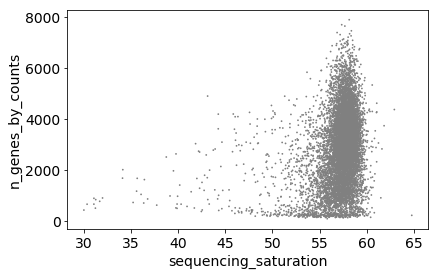

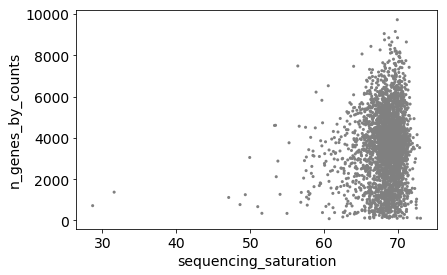

In [11]:
for adata_raw in adata_raws.values():
    sc.pl.scatter(adata_raw, y="n_genes_by_counts", x='sequencing_saturation')

In [12]:
qc_params = dict(
    min_cells_per_gene=3,
    min_counts_per_gene=3,
    min_genes_per_cell=500,
    max_genes_per_cell=8000,
    min_counts_per_cell=500,
    max_counts_per_cell=40000,
    max_pct_mitochondrial=30,
    max_counts_hemoglobin=1
)
qc_params = dict((sampleid, qc_params.copy()) for sampleid in adata_raws.keys())

In [13]:
qc_params["RV18002"].update(max_genes_per_cell=5500, max_counts_per_cell=30000)
qc_params["RV18003"].update(max_genes_per_cell=7000, max_counts_per_cell=35000)
qc_params["RV19001"].update(max_genes_per_cell=7000, max_counts_per_cell=30000)
qc_params["RV19002"].update(max_genes_per_cell=7000)
qc_params["RV19004"].update(max_genes_per_cell=8500, max_counts_per_cell=70000)
qc_params["RV19005"].update(max_genes_per_cell=6000, max_counts_per_cell=25000)
qc_params["RV19006"].update(max_genes_per_cell=9000, max_counts_per_cell=75000)
qc_params["RV19007"].update(max_genes_per_cell=7000, max_counts_per_cell=50000)
qc_params["RV19008"].update(max_counts_per_cell=50000)
qc_params["RV19009"].update(max_genes_per_cell=9000, max_counts_per_cell=80000)

In [14]:
trials = [sc.qc.run_qc(adata_raw, trial=True, **qc_params[sampleid])
          for sampleid, adata_raw in adata_raws.items()]

filtered out 8 cells that have more than  40000 counts
filtered out 1 cells that have more than  8000 genes expressed
filtered out 16931 genes that are detected in less than 3 cells
Original dims: (2068, 32738)
Filtered dims: (2021, 15807)
filtered out 6 cells that have more than  30000 counts
filtered out 5 cells that have more than  5500 genes expressed
filtered out 14185 genes that are detected in less than 3 cells
Original dims: (5840, 32738)
Filtered dims: (5774, 18553)
filtered out 9 cells that have more than  35000 counts
filtered out 383 cells that have less than 500 genes expressed
filtered out 2 cells that have more than  7000 genes expressed
filtered out 13182 genes that are detected in less than 3 cells
Original dims: (5382, 32738)
Filtered dims: (4819, 19556)
filtered out 6 cells that have more than  30000 counts
filtered out 451 cells that have less than 500 genes expressed
filtered out 2 cells that have more than  7000 genes expressed
filtered out 11800 genes that are de

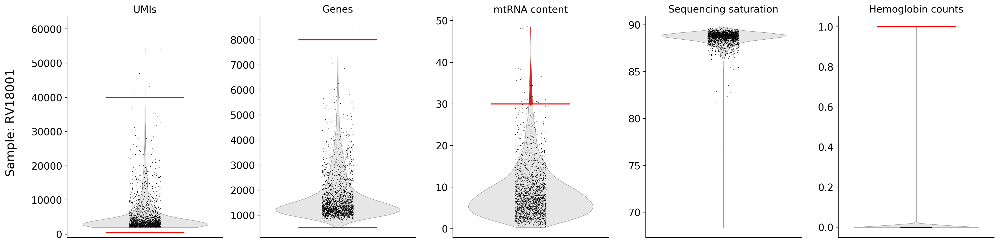

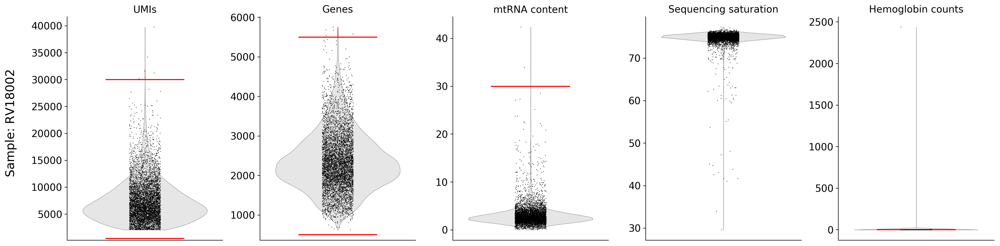

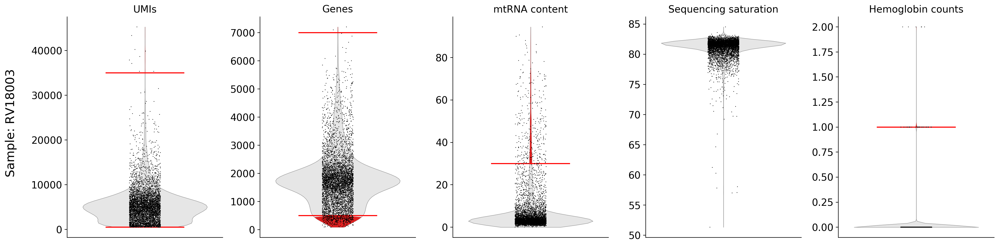

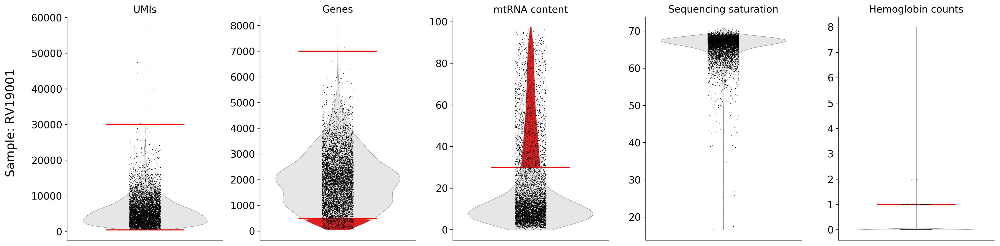

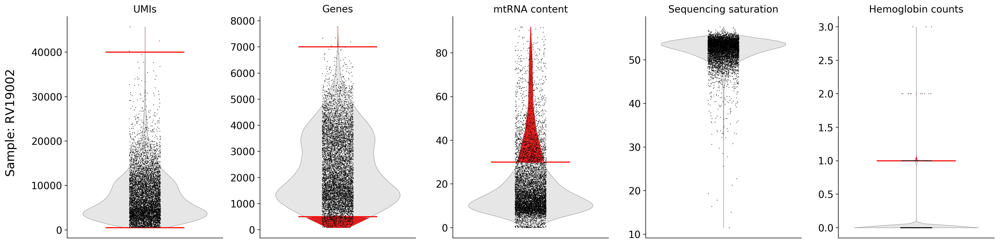

...

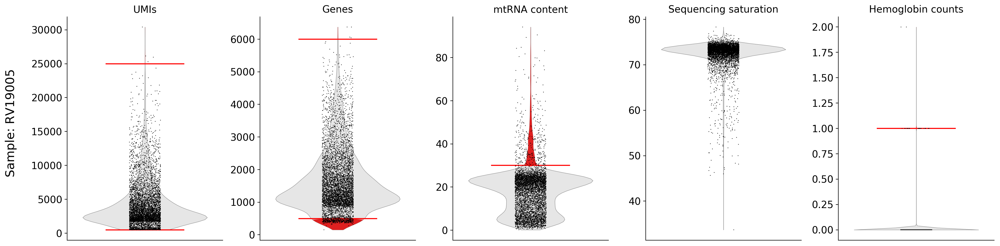

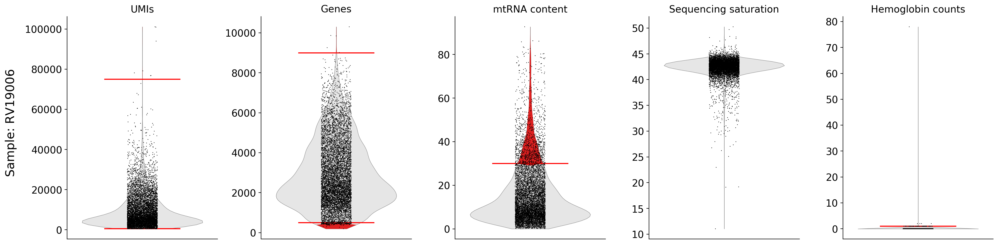

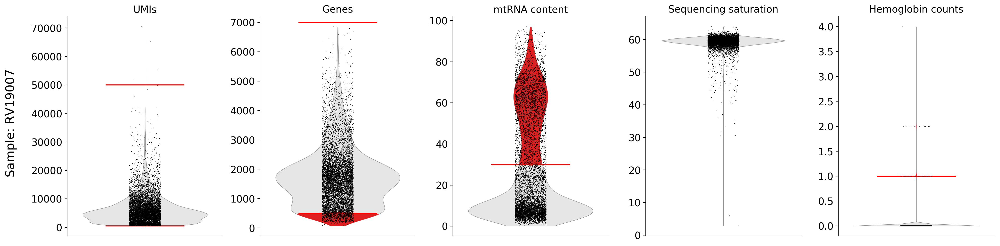

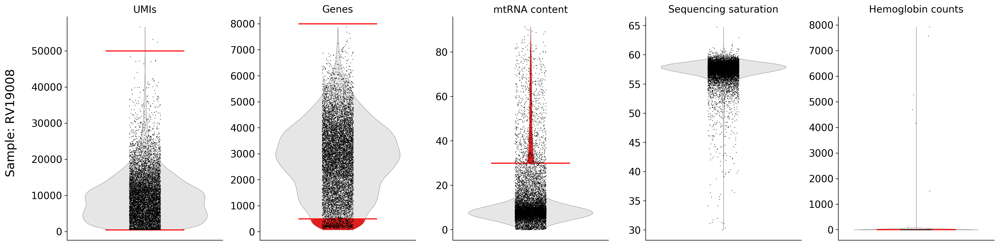

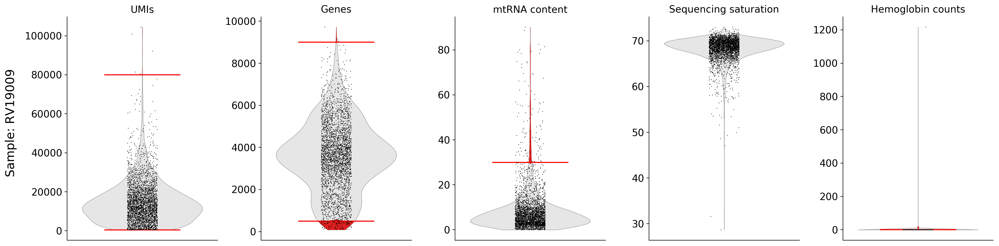

In [15]:
qc_figs = [sc.pl.qc_violins(trial, return_fig=True) for trial in trials]

# Predict doublets

In [16]:
import scrublet as scr
for sample in ['RV18001','RV18002','RV18003','RV19001','RV19002','RV19004','RV19005','RV19006','RV19007','RV19008','RV19009']:
    print(sample)
    scrub = scr.Scrublet(adata_raws[sample].X)
    doublet_scores, predicted_doublets = scrub.scrub_doublets()
    adata_raws[sample].obs["scrublet_predicted_doublets"] = predicted_doublets
    adata_raws[sample].obs["scrublet_scores"] = doublet_scores

RV18001
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.62
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.3%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 16.7%
Elapsed time: 2.5 seconds
RV18002
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.73
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.8%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 4.0%
Elapsed time: 8.3 seconds
RV18003
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.43
Detected doublet rate = 1.1%
Estimated detectable doublet fraction = 31.2%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 3.4%
Elapsed time: 7.4 seconds
RV19001
Pre

In [17]:
adata_qcs = [sc.qc.run_qc(adata_raw, trial=False, **qc_params[sampleid])
             for sampleid, adata_raw in adata_raws.items()]

filtered out 8 cells that have more than  40000 counts
filtered out 1 cells that have more than  8000 genes expressed
filtered out 16931 genes that are detected in less than 3 cells
Original dims: (2068, 32738)
Filtered dims: (2021, 15807)
filtered out 6 cells that have more than  30000 counts
filtered out 5 cells that have more than  5500 genes expressed
filtered out 14185 genes that are detected in less than 3 cells
Original dims: (5840, 32738)
Filtered dims: (5774, 18553)
filtered out 9 cells that have more than  35000 counts
filtered out 383 cells that have less than 500 genes expressed
filtered out 2 cells that have more than  7000 genes expressed
filtered out 13182 genes that are detected in less than 3 cells
Original dims: (5382, 32738)
Filtered dims: (4819, 19556)
filtered out 6 cells that have more than  30000 counts
filtered out 451 cells that have less than 500 genes expressed
filtered out 2 cells that have more than  7000 genes expressed
filtered out 11800 genes that are de

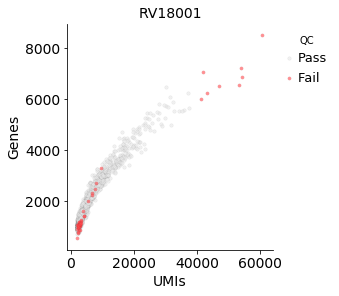

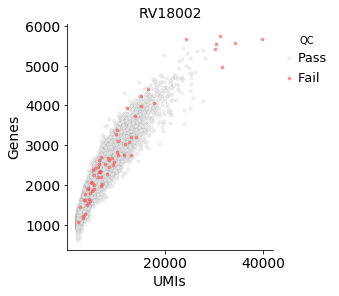

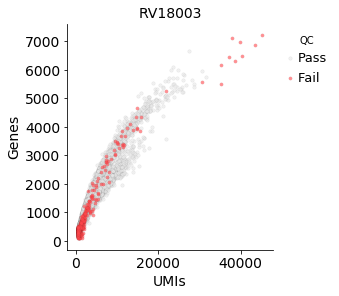

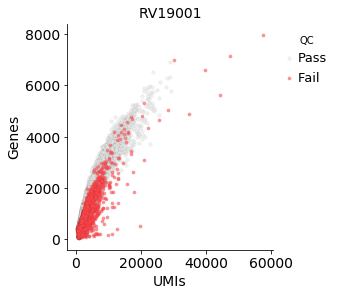

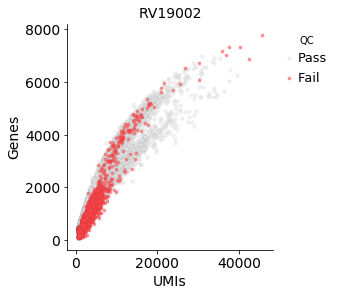

...

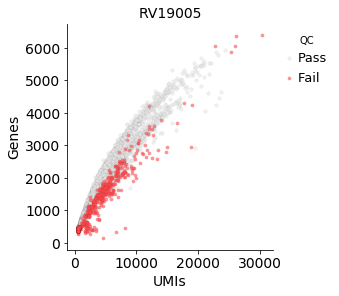

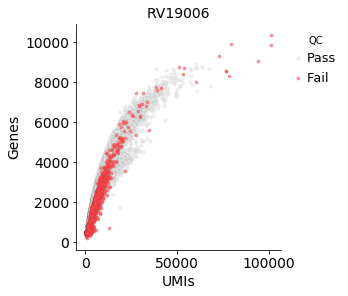

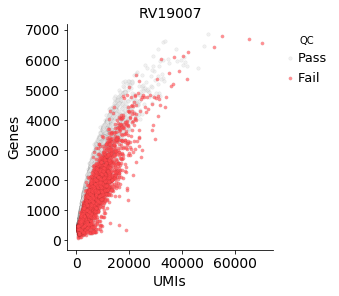

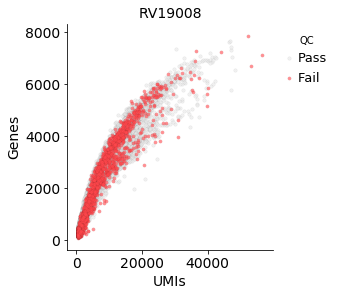

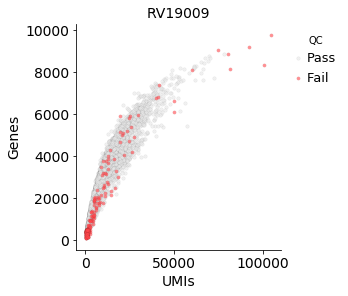

In [18]:
qc_figs2 = [sc.pl.qc_pass_fail(trial, return_fig=True) for trial in trials]

In [19]:
trials[10].obs_keys()

['sequencing_saturation',
 'n_genes_by_counts',
 'log1p_n_genes_by_counts',
 'total_counts',
 'log1p_total_counts',
 'pct_counts_in_top_50_genes',
 'pct_counts_in_top_100_genes',
 'pct_counts_in_top_200_genes',
 'pct_counts_in_top_500_genes',
 'total_counts_mitochondrial',
 'log1p_total_counts_mitochondrial',
 'pct_counts_mitochondrial',
 'total_counts_hemoglobin',
 'log1p_total_counts_hemoglobin',
 'pct_counts_hemoglobin',
 'qc_fail_counts',
 'qc_fail_genes',
 'qc_fail_seqsat',
 'qc_fail_mito',
 'qc_fail_rbc',
 'qc_fail']

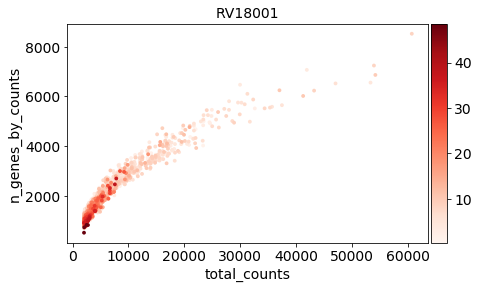

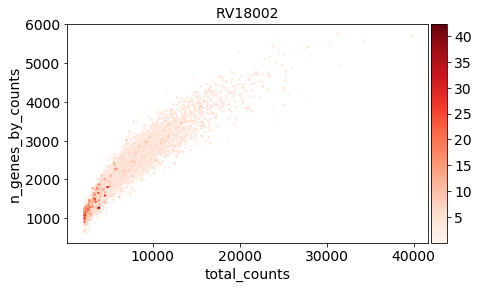

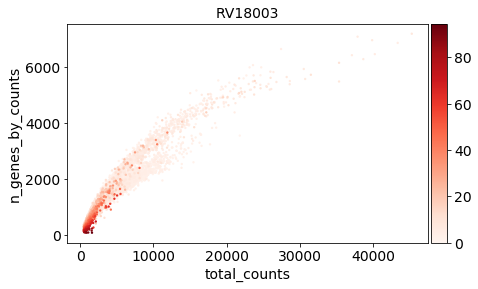

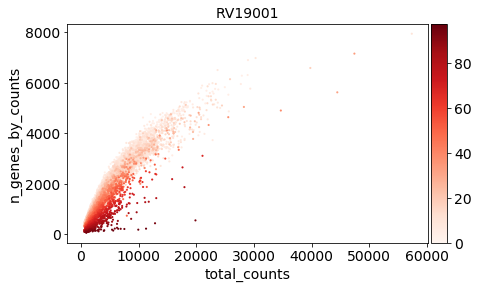

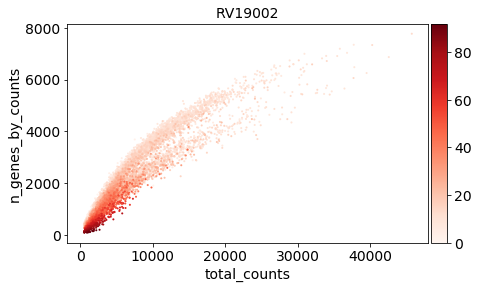

...

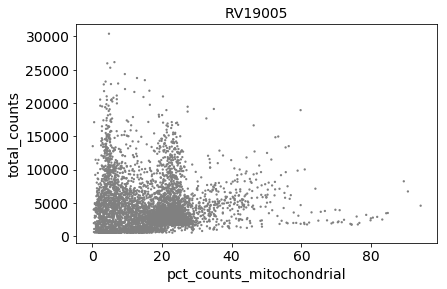

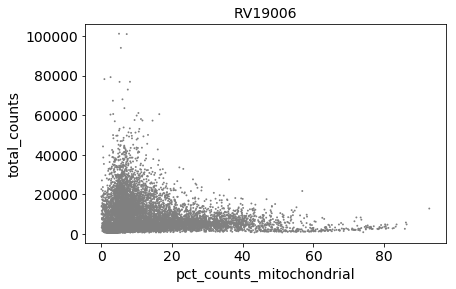

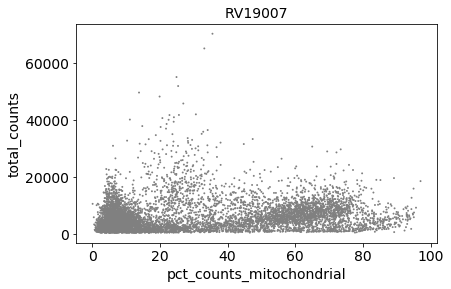

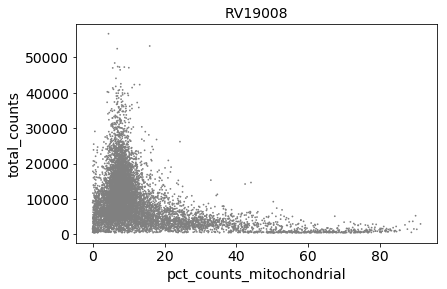

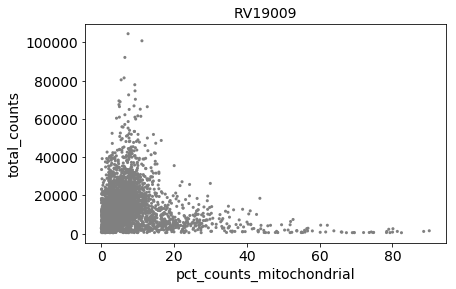

[None, None, None, None, None, None, None, None, None, None, None]

In [20]:
[sc.pl.scatter(trial, y="n_genes_by_counts", x="total_counts", color='pct_counts_mitochondrial', title = trial.uns["sampleid"]) for trial in trials]
[sc.pl.scatter(trial, y="n_genes_by_counts", x='pct_counts_mitochondrial', title = trial.uns["sampleid"]) for trial in trials]
[sc.pl.scatter(trial, y="total_counts", x='pct_counts_mitochondrial', title = trial.uns["sampleid"]) for trial in trials]

reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV18002-hg19/raw_gene_bc_matrices_h5.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:02.82)
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV18003/raw_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:02.04)
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19001/raw_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:08.97)
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19002/raw_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:09.42)
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19004-resequence/cellranger/raw_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:10.14)
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19005/cellranger/raw_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:08.80)
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19006/cellranger/raw_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:12.01)
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19007/cellranger/raw_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:11.15)
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19008/cellranger/raw_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:11.67)
reading /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/cellranger/RV19009/cellranger/raw_feature_bc_matrix.h5 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(0:00:09.68)


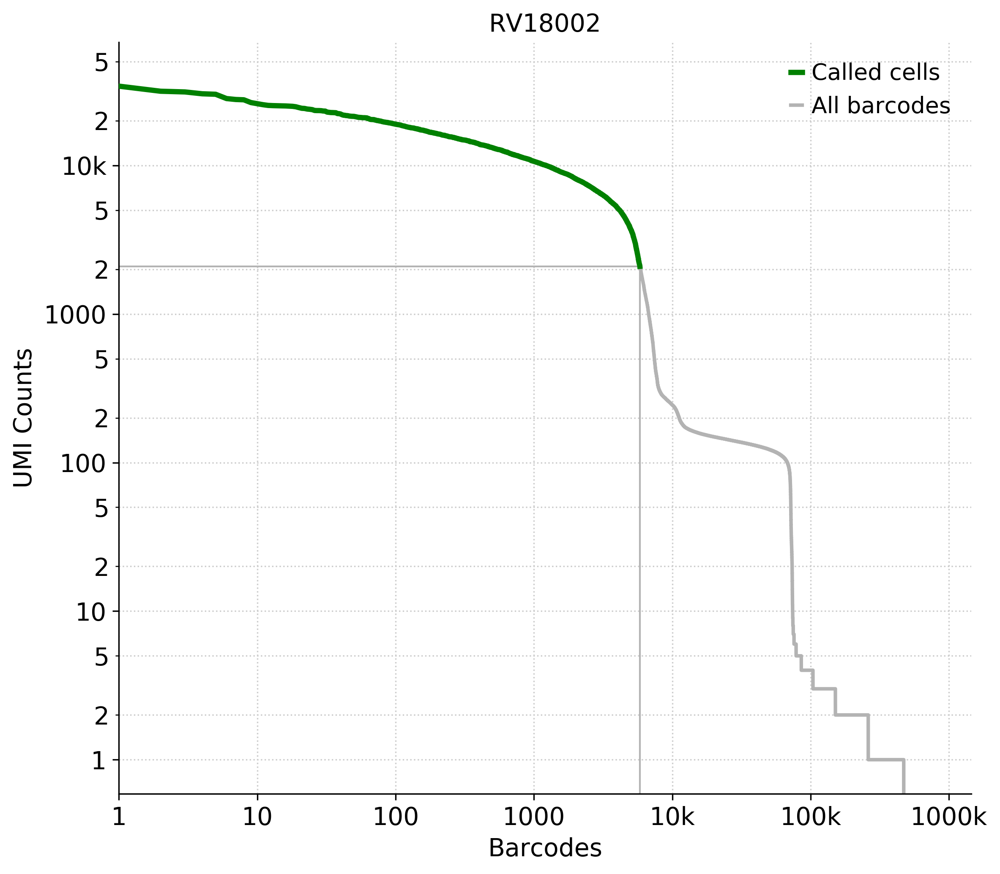

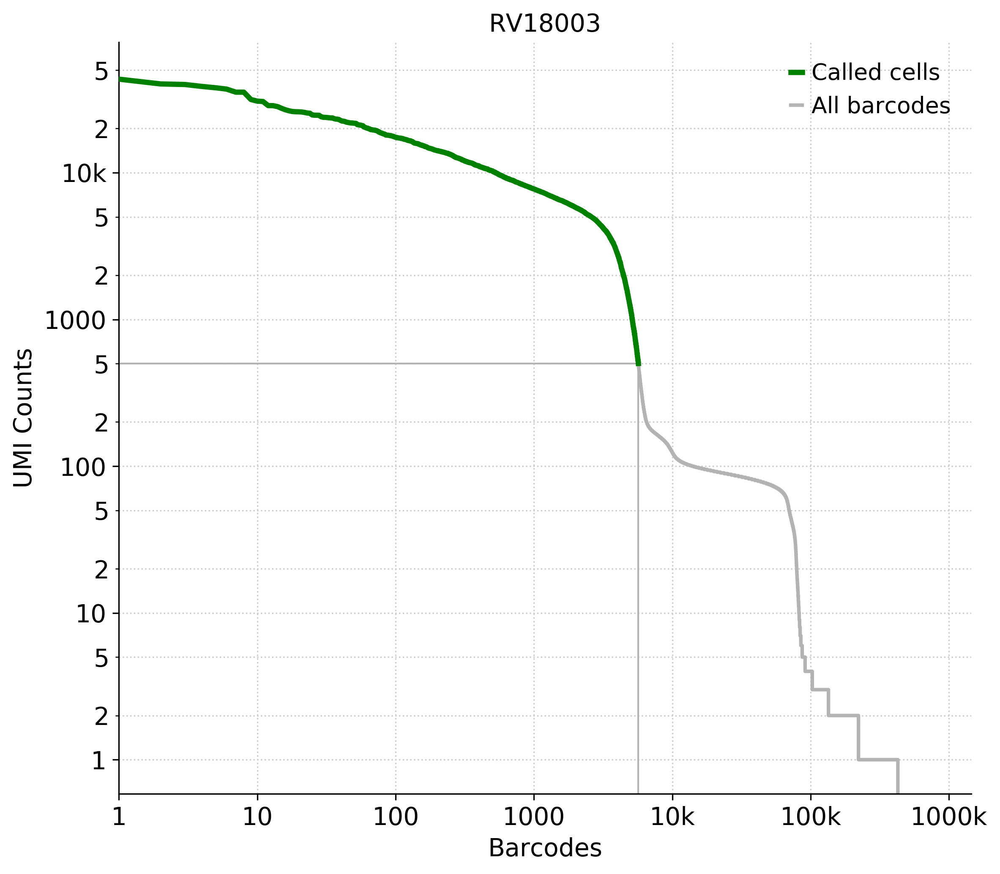

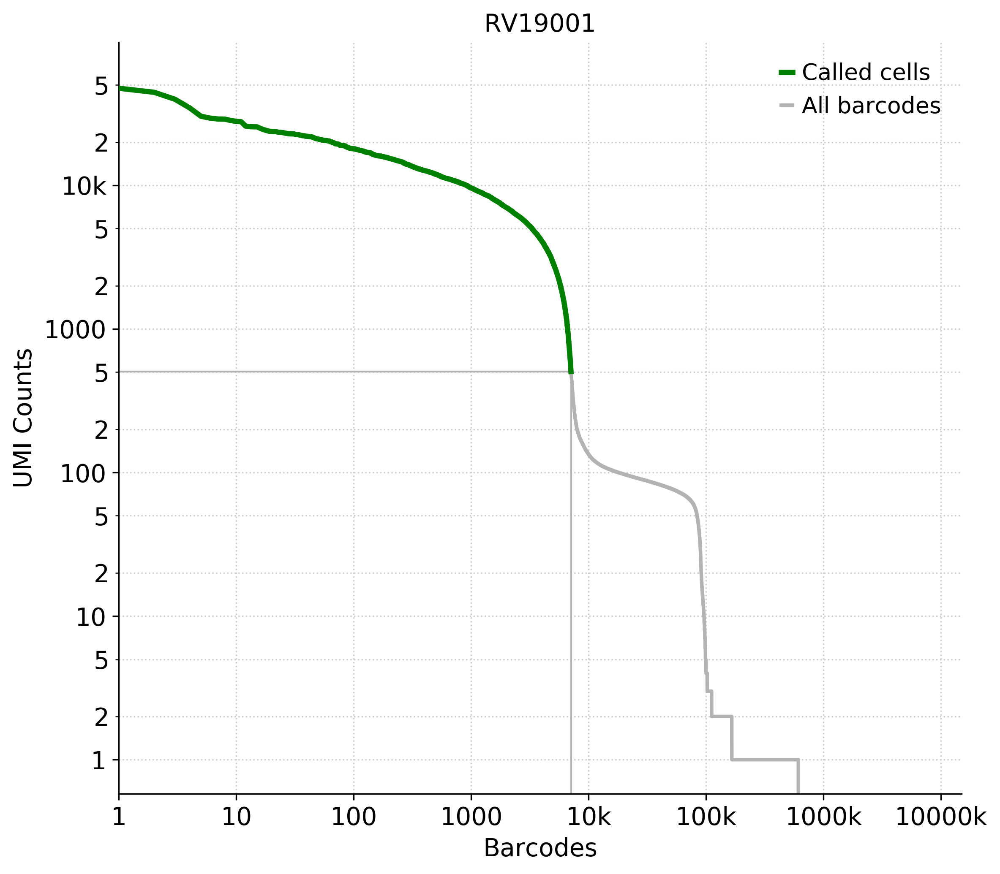

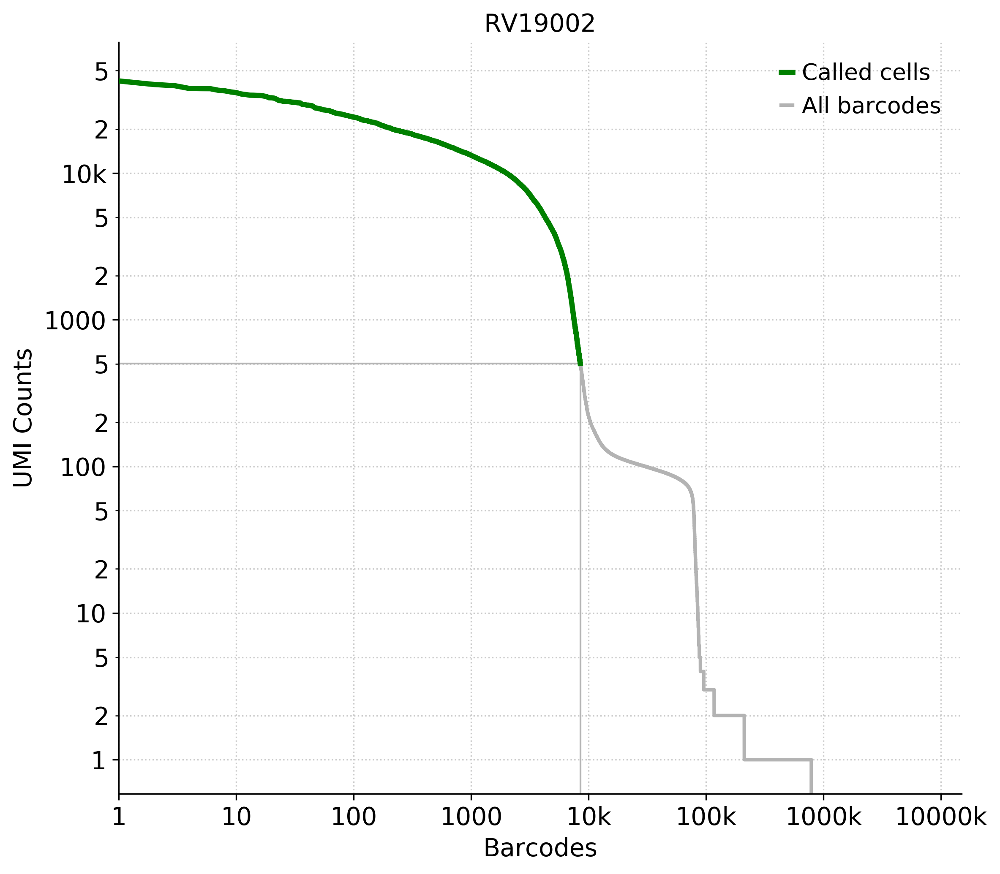

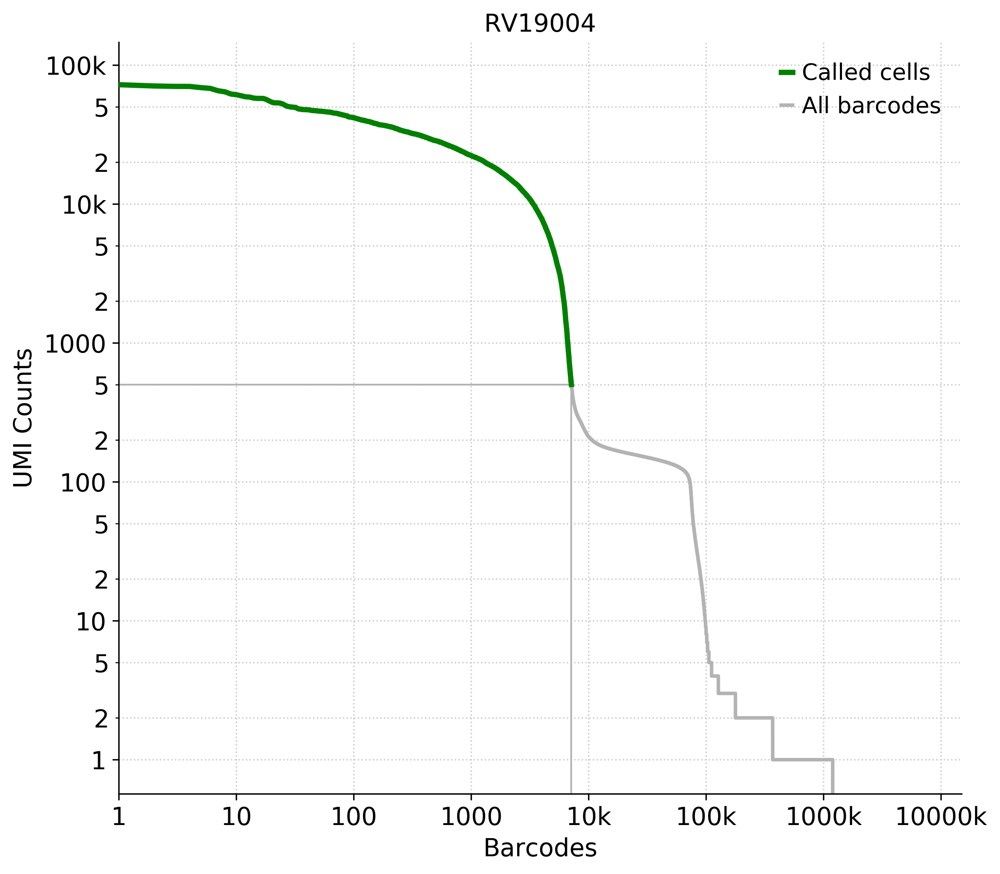

...

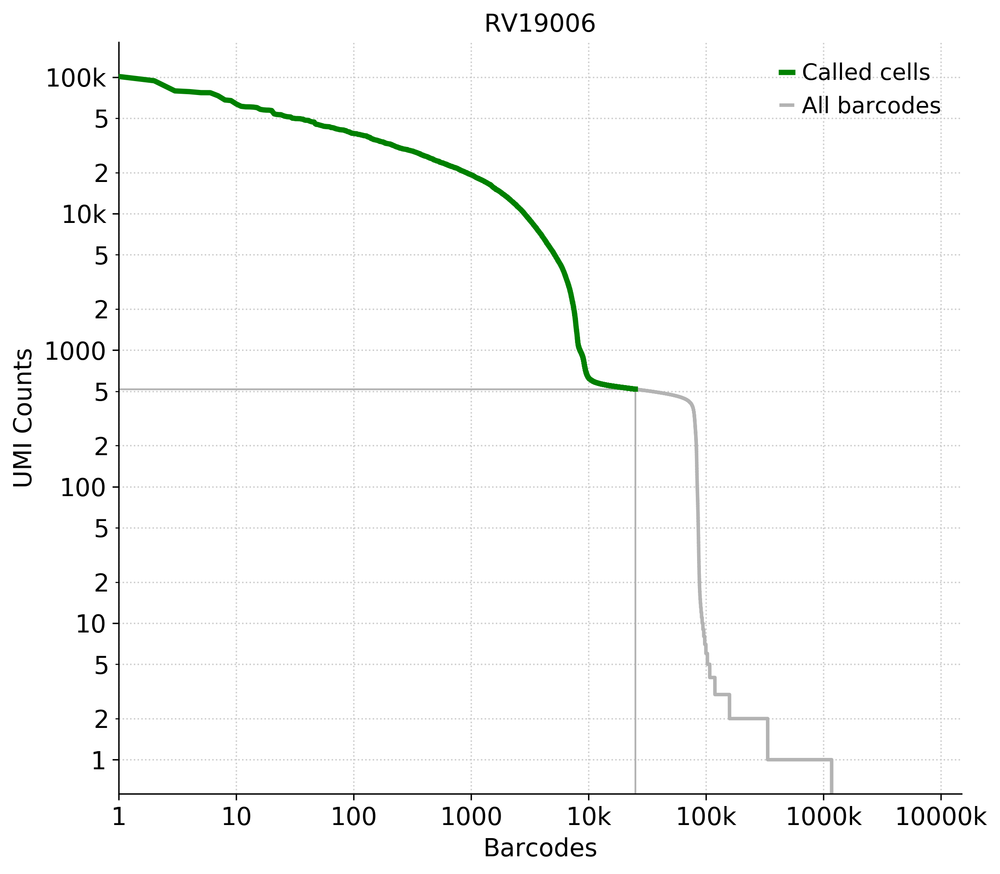

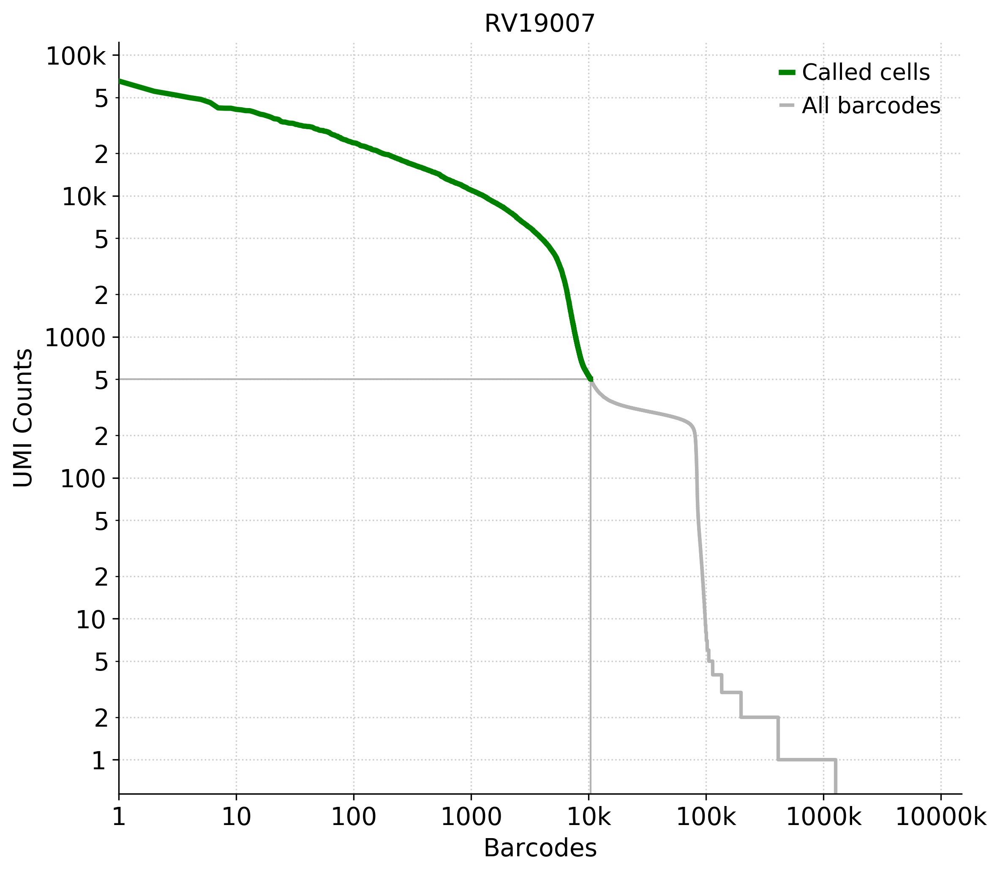

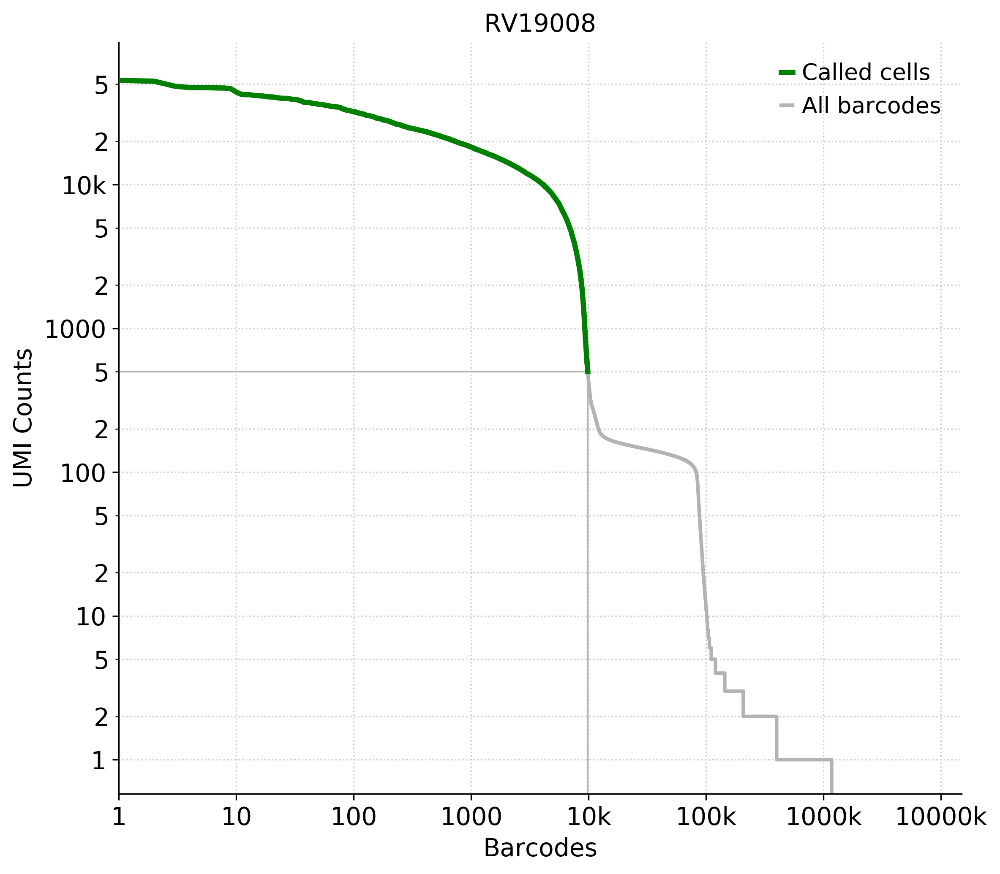

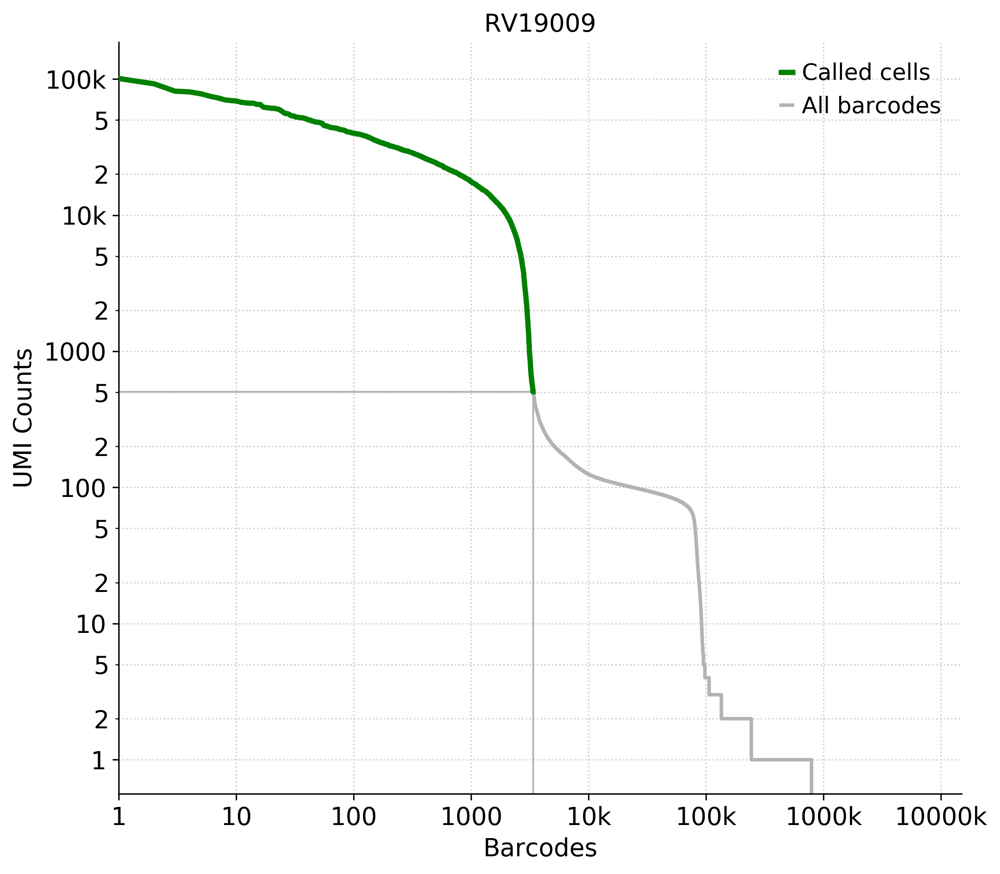

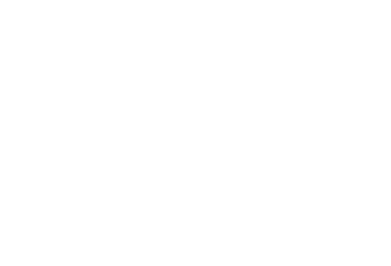

In [21]:
# No ranked plot for first sample RV18001
qc_fig3 = [sc.pl.umi_rank_plot(trial, return_fig=True) for trial in trials[1:11]]
empty, ax = plt.subplots()
ax.set_axis_off()
qc_fig3 = [empty] + qc_fig3

## Aggregation


In [47]:
combined_qc = sc.aggregate(
    adata_qcs,
    combined_output_dir=combined_output_dir,
    combined_sample_name=combined_sample_name,
    combined_sampleid=combined_sampleid,
    make_output_dir=True,
    del_batch_var=False
)

In [48]:
print("NUMBER OF CELLS:",combined_qc.shape)
print("MEDIAN GENES PER CELL: ", combined_qc.obs["n_genes_by_counts"].median())

NUMBER OF CELLS: (55284, 24703)
MEDIAN GENES PER CELL:  2340.0


In [28]:
#combined_qc.uns_keys()

In [49]:
qc_save_file = sc.save_adata(combined_qc, "qc")

... storing 'sampleid' as categorical


Saving RV18001-2-3-RV19001-2-4-5-6-7-8-9-qc_20190827.h5ad to /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9.


... storing 'sample_name' as categorical
... storing 'gene_ids-0' as categorical
... storing 'mitochondrial-0' as categorical
... storing 'hemoglobin-0' as categorical
... storing 'gene_ids-1' as categorical
... storing 'mitochondrial-1' as categorical
... storing 'hemoglobin-1' as categorical
... storing 'gene_ids-2' as categorical
... storing 'feature_types-2' as categorical
... storing 'genome-2' as categorical
... storing 'mitochondrial-2' as categorical
... storing 'hemoglobin-2' as categorical
... storing 'gene_ids-3' as categorical
... storing 'feature_types-3' as categorical
... storing 'genome-3' as categorical
... storing 'mitochondrial-3' as categorical
... storing 'hemoglobin-3' as categorical
... storing 'gene_ids-4' as categorical
... storing 'feature_types-4' as categorical
... storing 'genome-4' as categorical
... storing 'mitochondrial-4' as categorical
... storing 'hemoglobin-4' as categorical
... storing 'gene_ids-5' as categorical
... storing 'feature_types-5' as ca

## HVG selection, dimensionality reduction, and clustering

In [50]:
adata_qc = sc.read_h5ad(qc_save_file)

In [51]:
adata_redux = sc.pp.preprocess(adata_qc, n_top_genes=1500, scale=True)

--> added
    'highly_variable', boolean vector (adata.var)
    'means', boolean vector (adata.var)
    'dispersions', boolean vector (adata.var)
    'dispersions_norm', boolean vector (adata.var)


In [52]:
from scanpy_recipes.recipes.qc import read_hemoglobin_file, read_mito_file

In [53]:
mito_genes = read_mito_file("hg19")
hemo_genes = read_hemoglobin_file("hg19")

In [54]:
adata_redux.var["hemoglobin"] = adata_redux.var_names.isin(hemo_genes)
adata_redux.var['mitochondrial'] = adata_redux.var_names.isin(mito_genes)

In [55]:
adata_redux.var.loc[adata_redux.var.mitochondrial|adata_redux.var.hemoglobin, "highly_variable"] = False

In [56]:
adata_redux.var.groupby(("highly_variable","mitochondrial", "hemoglobin")).size()

highly_variable  mitochondrial  hemoglobin
False            False          False         23196
                 True           False            12
True             False          False          1495
dtype: int64

## Clustering

computing batch balanced neighbors
    finished (0:00:44.41) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:01:41.91) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing UMAP
    finished (0:01:54.21) --> added
    'X_umap', UMAP coordinates (adata.obsm)
2D UMAP available at `.obsm['X_umap']`
3D UMAP available at `.obsm['X_umap_3d']`
running Leiden clustering
    finished (0:00:44.75) --> found 8 clusters and added
    'cluster', the cluster labels (adata.obs, categorical)


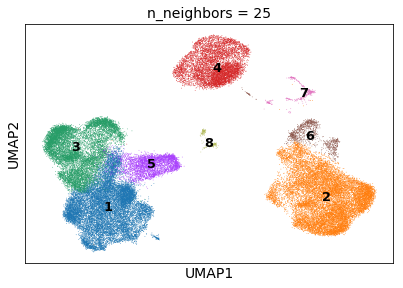

computing batch balanced neighbors
    finished (0:00:29.57) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:01:37.35) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing UMAP
    finished (0:01:52.61) --> added
    'X_umap', UMAP coordinates (adata.obsm)
2D UMAP available at `.obsm['X_umap']`
3D UMAP available at `.obsm['X_umap_3d']`
running Leiden clustering
    finished (0:00:47.05) --> found 8 clusters and added
    'cluster', the cluster labels (adata.obs, categorical)


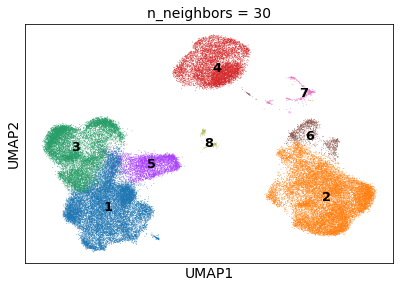

computing batch balanced neighbors
    finished (0:00:31.62) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:02:30.80) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing UMAP
    finished (0:02:21.36) --> added
    'X_umap', UMAP coordinates (adata.obsm)
2D UMAP available at `.obsm['X_umap']`
3D UMAP available at `.obsm['X_umap_3d']`
running Leiden clustering
    finished (0:01:36.83) --> found 8 clusters and added
    'cluster', the cluster labels (adata.obs, categorical)


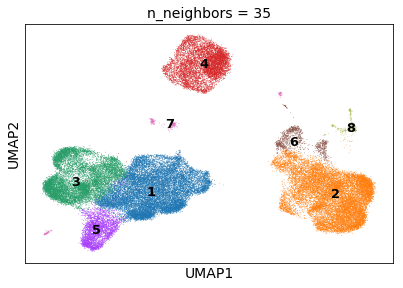

computing batch balanced neighbors
    finished (0:00:37.46) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:01:55.55) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing UMAP
    finished (0:01:45.38) --> added
    'X_umap', UMAP coordinates (adata.obsm)
2D UMAP available at `.obsm['X_umap']`
3D UMAP available at `.obsm['X_umap_3d']`
running Leiden clustering
    finished (0:01:19.18) --> found 8 clusters and added
    'cluster', the cluster labels (adata.obs, categorical)


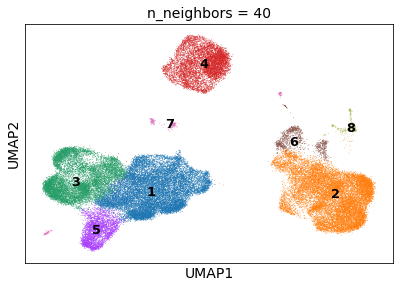

In [37]:
for n_neighbor in [25, 30, 35, 40]:
    sc.pp.dimensionality_reduction(adata_redux, n_neighbors=n_neighbor, min_dist=0.5)
    sc.tl.cluster(adata_redux, resolution=0.3)
    sc.pl.scatter(adata_redux, basis="umap", color="cluster", legend_loc="on data", title="n_neighbors = " + str(n_neighbor))

In [60]:
sc.pp.dimensionality_reduction(adata_redux, n_neighbors=35, min_dist=0.5)

computing batch balanced neighbors
    finished (0:00:27.07) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:01:37.26) --> added
    'X_umap', UMAP coordinates (adata.obsm)
computing UMAP
    finished (0:01:43.26) --> added
    'X_umap', UMAP coordinates (adata.obsm)
2D UMAP available at `.obsm['X_umap']`
3D UMAP available at `.obsm['X_umap_3d']`


We can visualize the aggregation by `"sample_name"`, `"sampleid"`, or `"batch"`!

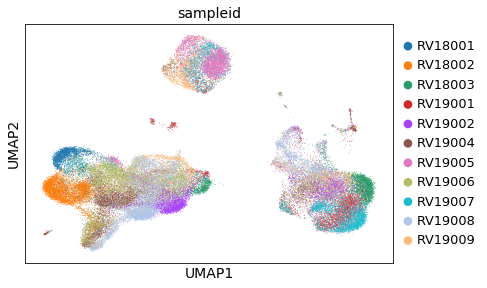

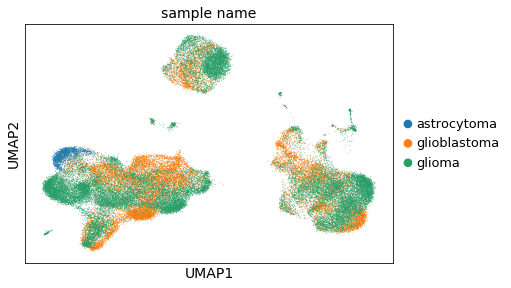

In [61]:
sc.pl.scatter(adata_redux, basis="umap", color="sampleid", show=False)
sc.pl.scatter(adata_redux, basis="umap", color="sample_name", show=False)

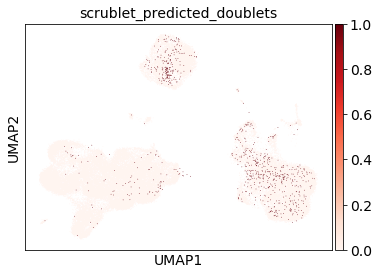

In [62]:
sc.pl.umap(adata_redux, color=['scrublet_predicted_doublets'], use_raw=False)

In [67]:
sc.tl.cluster(adata_redux, resolution=0.4)

running Leiden clustering
    finished (0:02:27.12) --> found 8 clusters and added
    'cluster', the cluster labels (adata.obs, categorical)


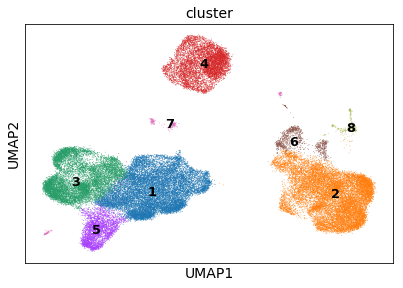

In [68]:
sc.pl.scatter(adata_redux, basis="umap", color="cluster", legend_loc="on data")

In [74]:
sc.tl.subcluster(adata_redux, cluster="7", cluster_key="cluster", resolution=0.8)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00.07) --> found 4 clusters and added
    'cluster_R1', the cluster labels (adata.obs, categorical)
Updated clusters under `adata_redux.obs['cluster_R1']`.


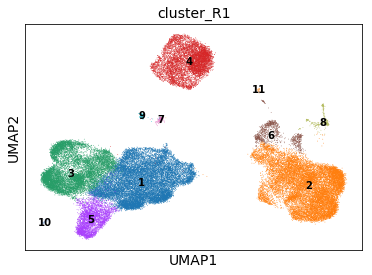

In [75]:
sc.pl.umap(adata_redux, color="cluster_R1", legend_loc="on data")

In [82]:
sc.tl.subcluster(adata_redux, cluster = '6', cluster_key='cluster_R1', resolution=0.3)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00.31) --> found 2 clusters and added
    'cluster_R2', the cluster labels (adata.obs, categorical)
Updated clusters under `adata_redux.obs['cluster_R2']`.


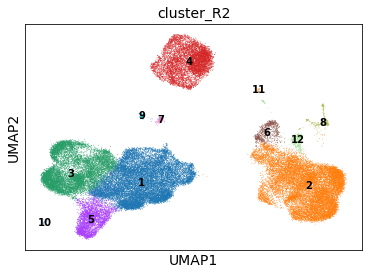

In [83]:
sc.pl.umap(adata_redux, color="cluster_R2", legend_loc="on data")

## Marker gene detection

In [84]:
markers = sc.tl.find_marker_genes(adata_redux, "cluster_R2", log_fold_change=1.0)

1 2 3 4 5 6 7 8 9 10 11 12 
Computed markers for 12 clusters.


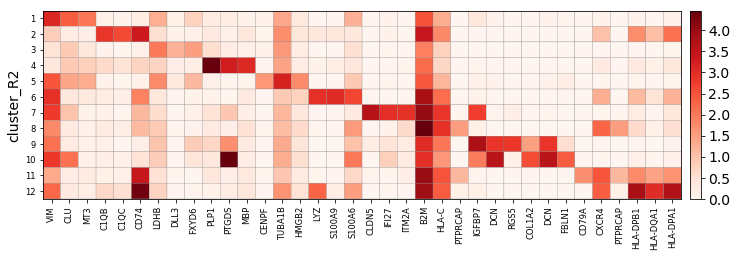

In [85]:
top3_genes = markers.groupby("cluster_R2").head(3).gene_name.values
sc.pl.matrixplot(adata_redux, top3_genes, groupby="cluster_R2", log=True)

In [86]:
sc.export_markers(adata_redux, "cluster_R2")

CSV file saved to [/home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/RV18001-2-3-RV19001-2-4-5-6-7-8-9_markers_20190827.csv].
Excel file saved to [/home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/RV18001-2-3-RV19001-2-4-5-6-7-8-9_markers_20190827.xlsx].


In [87]:
adata_redux.obs.sampleid.to_csv("RV8001-2-3-RV19001-2-4-5-6-7-8-9_redux_sampleid_20190827.csv")

In [88]:
adata_redux.obs.cluster_R2.to_csv("RV8001-2-3-RV19001-2-4-5-6-7-8-9_redux_cluster_20190827.csv")

In [89]:
adata_redux.obs.cluster_R2.astype(str).str.pad(width=2, fillchar="0").values

array(['03', '01', '03', ..., '02', '01', '02'], dtype=object)

In [90]:
cloupe_clusters = pd.DataFrame(
    "Cluster" + adata_redux.obs.cluster_R2.astype(str).str.pad(width=2, fillchar="0").values,
    columns = ["cluster_custom"]
)
cloupe_clusters.index.name = "barcode"

In [91]:
cloupe_clusters.to_csv("RV8001-2-3-RV19001-2-4-5-6-7-8-9_padding_cluster_20190827.csv")

In [92]:
# get coordinates of umap for integration in Cloupe
tmp = pd.DataFrame(index=adata_redux.obs_names)
tmp["x coordinate"] = adata_redux.obsm["X_umap"][:,0]
tmp["y coordinate"] = adata_redux.obsm["X_umap"][:,1]

In [93]:
tmp.head()

,x coordinate,y coordinate
index,,
AAACCTGAGGACCACA-1-0,-9.817900,1.293109
AAACCTGCAAATACAG-1-0,-5.166081,-3.136598
AAACCTGTCACTGGGC-1-0,-8.952465,1.311805
AAACGGGGTGAGTATA-1-0,5.687478,-2.114773
AAACGGGGTGCAACGA-1-0,-9.232838,2.187068


In [94]:
tmp.to_csv("RV8001-2-3-RV19001-2-4-5-6-7-8-9_redux_xumap_20190827.csv")

## Saving outputs

In [95]:
sc.save_adata_to_rds(adata_redux, cluster_key="cluster_R2", scheduler= 'local')

Saved counts to /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/RV18001-2-3-RV19001-2-4-5-6-7-8-9_counts.csv.
Saved features to /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/RV18001-2-3-RV19001-2-4-5-6-7-8-9_features.csv.
Saved umap3d to /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/RV18001-2-3-RV19001-2-4-5-6-7-8-9_umap3d.csv.
Rds creation submitted as local job [1] "Done".
Output will be located in [/home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9].


In [96]:
redux_save_file = sc.save_adata(adata_redux, "redux")

Saving RV18001-2-3-RV19001-2-4-5-6-7-8-9-redux_20190828.h5ad to /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9.


## Report generation

Report generation currently under construction for aggregated datasets.

In [26]:
adata_redux = sc.read_h5ad("/home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/RV18001-2-3-RV19001-2-4-5-6-7-8-9-redux_20190828.h5ad")

In [27]:
report = sc.SCBLReport()

In [28]:
report.add_report_figures(
    adata_redux,
    violins=qc_figs,
    scatters=qc_figs2,
    ranks=qc_fig3,
    cluster_key="cluster_R2",
    batch_key="sampleid"
)

In [29]:
report.generate_report(adata_redux)

HTML report saved to [/home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/RV18001-2-3-RV19001-2-4-5-6-7-8-9_20190828_report.html].


In [24]:
adata_redux = sc.read_h5ad("/home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/RV18001-2-3-RV19001-2-4-5-6-7-8-9-redux_20190828.h5ad")

In [25]:
adata_redux.obsm_keys()

['X_pca', 'X_umap', 'X_umap_3d']

In [26]:
adata_redux.obsm['X_umap_3d']

array([[-5.22204087,  2.69550131,  0.40774518],
       [-4.14431305, -1.93009932,  2.22730225],
       [-5.85700407,  2.27563061, -0.08756976],
       ...,
       [ 5.13167448, -2.17226485, -2.45061338],
       [-3.61037728, -3.11243865, -0.12658095],
       [ 7.29003363, -3.72746306,  0.53769668]])

In [27]:
adata_redux.obsm['X_umap']

array([[-9.81790005,  1.29310916],
       [-5.16608098, -3.13659764],
       [-8.95246512,  1.31180455],
       ...,
       [ 5.18972407,  0.60254425],
       [-2.39004661, -2.68147403],
       [ 7.25720549, -2.6564769 ]])

# Output 2d embedding

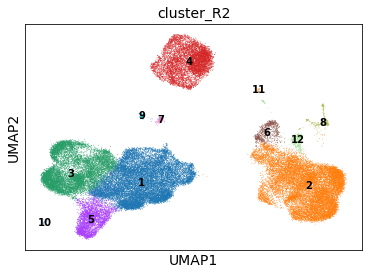

In [28]:
sc.pl.umap(adata_redux, color="cluster_R2", legend_loc="on data")

In [29]:
adata_redux.uns["output_dir"]

'/home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9'

In [31]:
import os
def save_2d_embedding(adata, cluster_key="cluster_revised"):
    final_barcodes = adata.obs_names
    loupe_barcodes = pd.DataFrame(final_barcodes)
    loupe_barcodes.columns = ["Barcode"]    

    cloupe_umap = pd.DataFrame(adata.obsm["X_umap"],
                    index=loupe_barcodes.Barcode.values,
                    columns=["x coordinate", "y coordinate"]
                    )
    cloupe_umap.index.name = "barcode"
    print(cloupe_umap.head())
    cloupe_umap.to_csv(os.path.join(adata.uns["output_dir"], "RV8001-2-3-RV19001-2-4-5-6-7-8-9_umap_2d_embedding.csv"))

In [32]:
save_2d_embedding(adata_redux, cluster_key="cluster_R2")

                      x coordinate  y coordinate
barcode                                         
AAACCTGAGGACCACA-1-0     -9.817900      1.293109
AAACCTGCAAATACAG-1-0     -5.166081     -3.136598
AAACCTGTCACTGGGC-1-0     -8.952465      1.311805
AAACGGGGTGAGTATA-1-0      5.687478     -2.114773
AAACGGGGTGCAACGA-1-0     -9.232838      2.187068


In [19]:
# Generate rds with 2d embedding by setting v3 to zero
#adata.obsm["X_umap_3d"] = np.column_stack((adata.obsm["X_umap"] , np.zeros(adata.shape[0])))
adata_redux.obsm['X_umpa_3d'] = np.column_stack((adata_redux.obsm['X_umap'], np.zeros(adata_redux.shape[0])))

In [21]:
#Generate .rds file with 2d coordinates
sc.save_adata_to_rds(adata_redux, cluster_key = "cluster_R2", scheduler = 'local')

Saved counts to /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/RV18001-2-3-RV19001-2-4-5-6-7-8-9_counts.csv.
Saved features to /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/RV18001-2-3-RV19001-2-4-5-6-7-8-9_features.csv.
Saved umap3d to /home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9/RV18001-2-3-RV19001-2-4-5-6-7-8-9_umap3d.csv.
Rds creation submitted as local job [1] "Done".
Output will be located in [/home/seignm/projects/10x_runs/RV8001-2-3-RV19001-2-4-5-6-7-8-9].
